In [1]:
using Pkg
include("/cluster/home/danare/git/Clustering/TSClustering.jl")
cd("/cluster/home/danare/git/Clustering")
Pkg.activate(".")
using .TSClustering
using Distances
using Clustering
using DelimitedFiles
using DataFrames
using DynamicAxisWarping
using Dates
using Statistics
using CSV
using PlotlyJS

  Activating project at `~/git/Clustering`


# Heat Maps for Warping Matrix

In [2]:
# config
path = "/cluster/home/danare/git/GENeSYS_MOD.data/Output/output_excel/Timeseries.xlsx"
config = "/cluster/home/danare/git/Clustering/data/config5.yml"
k=6;
country = "DE";
config = TSClustering.read_yaml_file(file=config);

In [3]:
data_org = TSClustering.read_data(path=path, config=config);
data_clustering_org = TSClustering.create_clustering_matrix(config=config, CountryData=data_org);
# apply normalization
data = TSClustering.normalize_data(CountryData=data_org, config=config);
data_clustering = TSClustering.create_clustering_matrix(config=config, CountryData=data);

In [4]:
eucl = TSClustering.define_distance(w=0, data_clustering=data_clustering, fast_dtw=false);
dtw = TSClustering.define_distance(w=1, data_clustering=data_clustering, fast_dtw=false);

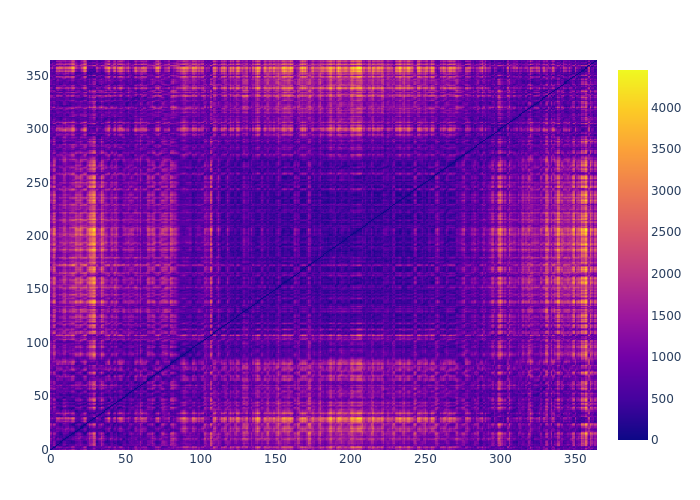

In [5]:
TSClustering.plot_basic_heatmap(matrix=dtw)

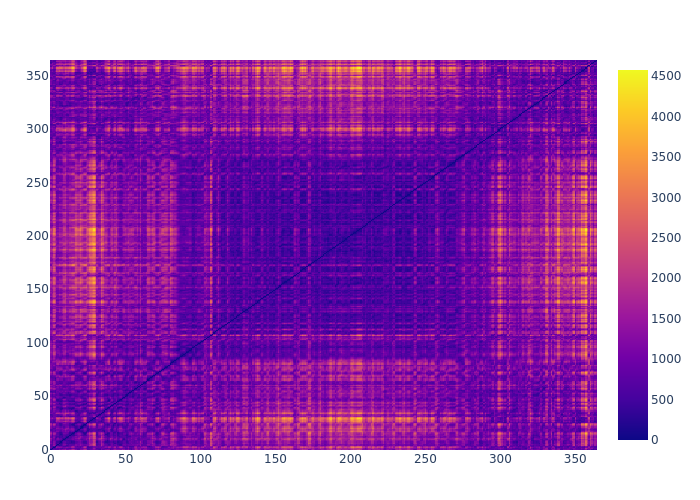

In [20]:
TSClustering.plot_basic_heatmap(matrix=eucl)

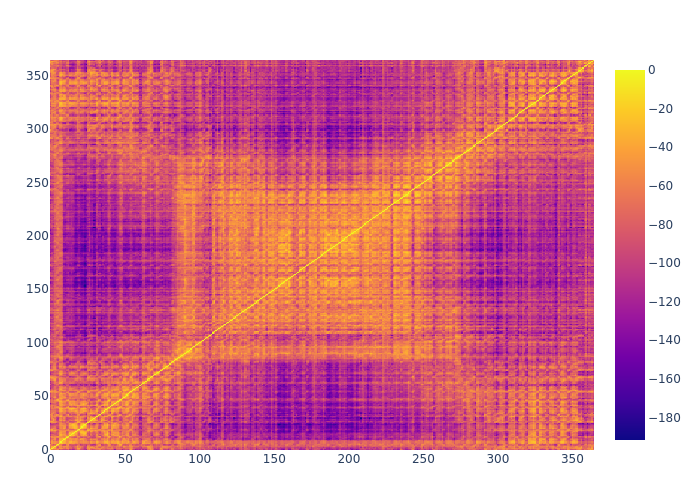

In [19]:
TSClustering.plot_basic_heatmap(matrix=z)

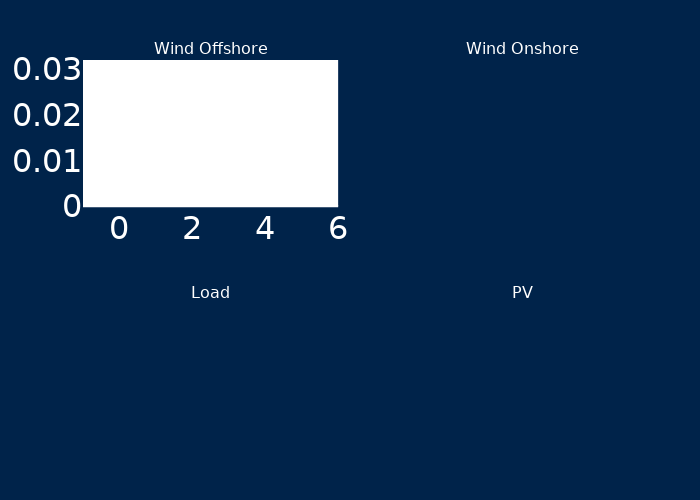

In [7]:
p = make_subplots(rows=2, 
cols=2, 
subplot_titles= ["Wind Offshore" "Wind Onshore" "Load" "PV"]
)

for (i, j, k) in zip([], [1,1,2,2], [1,2,1,2], [true,false,false,false])
    z = cor(dtw)
    add_trace!(p,
    heatmap(z=z,
    colorscale="PdBu",
    showscale=k,
    y=names(data_org[df]),
    x=names(data_org[df])),
    row=i, col=j)
end


relayout!(p)
TSClustering.format_layout(p=p, max_value=0)
p

In [8]:
#x1 = create_clustering_matrix(time_series1=data["LOAD"][:,"DE"], distance="Euclidean");
#x2 = create_clustering_matrix(time_series1=data["WIND_ONSHORE_AVG"][:,"DE"], distance="Euclidean");
#x3 = create_clustering_matrix(time_series1=data["PV_AVG"][:,"DE"], distance="Euclidean");
#x4 = create_clustering_matrix(time_series1=data["WIND_OFFSHORE_SHALLOW"][:,"DE"], distance="Euclidean");
y1 = TSClustering.define_distance(w=w,data_clustering=data_clustering, fast_dtw=false);
y2 = TSClustering.define_distance(w=w,data_clustering=data["WIND_ONSHORE_AVG"][:,"DE"], fast_dtw=false);
y3 = TSClustering.define_distance(w=w,data_clustering=data["PV_AVG"][:,"DE"], fast_dtw=false);
y4 = TSClustering.define_distance(w=w,data_clustering=data["WIND_OFFSHORE_SHALLOW"][:,"DE"], fast_dtw=false);

UndefVarError: UndefVarError: `w` not defined

In [9]:
dtw

365×365 Matrix{Float64}:
    0.0     506.343   829.442   656.142  …   379.425   587.975   467.77
  506.343     0.0     463.731   567.619      677.47    770.083   784.364
  829.442   463.731     0.0     404.954      803.58    515.688   527.357
  656.142   567.619   404.954     0.0        597.566   590.12    503.935
  679.392   729.543  1416.83    869.805      835.777  1474.21   1108.16
  706.005   595.751  1166.92   1043.36   …   976.415  1500.55   1224.29
 1092.26    712.216  1296.18    870.435     1151.22   1519.02   1327.36
  923.783   545.399  1184.17    943.788     1232.22   1482.66   1237.23
 1153.05    478.959   930.883   766.469      932.896  1313.94   1313.77
 1178.52    691.124   953.939   557.786      967.49   1361.03   1364.16
    ⋮                                    ⋱                      
  817.133   820.53    556.388   682.499      851.275   336.059   425.668
 1289.41   1793.17   1042.18   1178.85      1070.14    554.534   742.019
  571.706  1259.57    883.269   807.51   

In [10]:
p = PlotlyJS.make_subplots(rows=2, 
cols=2, 
vertical_spacing=0.02,
subplot_titles = ["LOAD" "PV"; "WindON" "WIND OFF"]
)

for (w,i) in zip([x1,x2,x3,x4], [(1,1), (1,2), (2,1), (2,2)])
    add_trace!(p,
    PlotlyJS.heatmap(z=w,
    y=1:365,
    x=1:365),
    row=i[1], col=i[2])
end


relayout!(p)
p

UndefVarError: UndefVarError: `x1` not defined

In [11]:
PlotlyJS.savefig(p, "eucl.html")

"eucl.html"

In [12]:
p = PlotlyJS.make_subplots(rows=2, 
cols=2, 
vertical_spacing=0.02,
subplot_titles = ["LOAD" "PV"; "WindON" "WIND OFF"]
)

for (w,i) in zip([y1,y2,y3,y4], [(1,1), (1,2), (2,1), (2,2)])
    add_trace!(p,
    PlotlyJS.heatmap(z=w,
    y=1:365,
    x=1:365),
    row=i[1], col=i[2])
end


relayout!(p)
p

UndefVarError: UndefVarError: `y1` not defined

In [13]:
PlotlyJS.savefig(p, "dtw.html")

"dtw.html"

In [14]:
cost, a,b = dtw(data["LOAD"][1:24,"DE"],data["LOAD"][25:48,"DE"], Euclidean())
a

KeyError: KeyError: key "LOAD" not found

In [15]:
b

UndefVarError: UndefVarError: `b` not defined

In [16]:
y1[2,1]

UndefVarError: UndefVarError: `y1` not defined

## Find Cost Delta

In [17]:
for (i,j,n) in zip([x1,x2,x3,x4], [y1,y2,y3,y4], ["LOAD", "Windon", "PV", "Windoff"])
    println("$n the delta is $(sum(j)-sum(i))")
end

UndefVarError: UndefVarError: `x1` not defined